# P-139 HOTEL-REVIEW-CLASSIFICATION using NLP 
### Group-2

In [3]:
# Importing libraries

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
# plotly libraries
from mpl_toolkits.mplot3d import Axes3D
import plotly.graph_objects as go
import plotly.express as px

In [4]:
import warnings
warnings.filterwarnings("ignore")

In [5]:
# Importing the data

data = pd.read_excel(r'C:\Users\SOUMYA\Downloads\Project 139\hotel_reviews.xlsx')

In [6]:
data

,Review,Rating
0,nice hotel expensive parking got good deal sta...,4.0
1,ok nothing special charge diamond member hilto...,2.0
2,nice rooms not 4* experience hotel monaco seat...,3.0
3,"unique, great stay, wonderful time hotel monac...",5.0
4,"great stay great stay, went seahawk game aweso...",5.0
...,...,...
20486,"best kept secret 3rd time staying charm, not 5...",5.0
20487,great location price view hotel great quick pl...,4.0
20488,"ok just looks nice modern outside, desk staff ...",2.0
20489,hotel theft ruined vacation hotel opened sept ...,1.0


# Exploratory Data Analysis and Inferencing

### Basic Statistics:

In [8]:
def initial_EDA():
    print("Summary \n\n", data.describe())
    print("\n--------------------------------------------\n")
    print("Shape\n\n", data.shape)
    print("\n--------------------------------------------\n")
    print("Data Types\n\n", data.dtypes)
    print("\n--------------------------------------------\n")
    print("Missing Values any?\n\n", data.isnull().sum())
    print("\n--------------------------------------------\n")
    print("Any Duplicate Values?\n\n", data.duplicated().sum())
    print("\n--------------------------------------------\n")
    print("Correlation\n\n", data.corr())
initial_EDA()

Summary 

              Rating
count  20491.000000
mean       3.952223
std        1.233030
min        1.000000
25%        3.000000
50%        4.000000
75%        5.000000
max        5.000000

--------------------------------------------

Shape

 (20491, 2)

--------------------------------------------

Data Types

 Review     object
Rating    float64
dtype: object

--------------------------------------------

Missing Values any?

 Review    0
Rating    0
dtype: int64

--------------------------------------------

Any Duplicate Values?

 0

--------------------------------------------

Correlation

         Rating
Rating     1.0


In [9]:
# look at the descriptive data set

data["Rating"].describe().round(2)

count    20491.00
mean         3.95
std          1.23
min          1.00
25%          3.00
50%          4.00
75%          5.00
max          5.00
Name: Rating, dtype: float64

- The average around 4 , it is good

<AxesSubplot:xlabel='Rating', ylabel='count'>

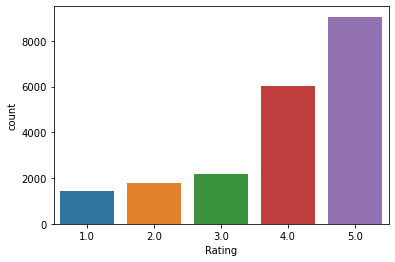

In [10]:
# Ploting the ratings count plot.

sns.countplot(x='Rating', data=data)

<AxesSubplot:xlabel='Rating', ylabel='Density'>

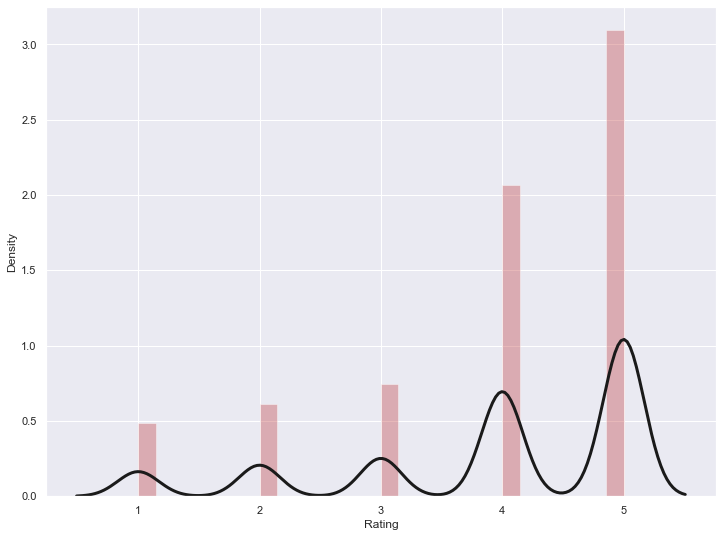

In [11]:
sns.set(rc={'figure.figsize':(12,9)})
sns.set_color_codes()
sns.distplot(data['Rating'],
                  kde_kws={"color": "k", "lw": 3, "label": "KDE"}, color="r")

<AxesSubplot:ylabel='Rating'>

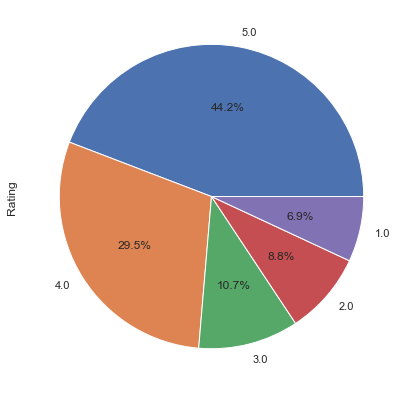

In [12]:
# The Percentage of Rating
plt.figure(figsize=(7,7))
data['Rating'].value_counts().plot(kind='pie', autopct='%1.1f%%')   

### The percentage rating:-
- 5 = 44%
- 4 = 30%
- 3 = 11% 
- 2 = 9%
- 1 = 7% 
- We can Infer that Maximum Rating Weightage is for 5 and 4

### Relation between the length of the reviews and the ratings

In [13]:
# Length of Word in Sentence (i.e character lengths)
## Creating a seperate column for the Review_length

data['Review_length'] = data['Review'].apply(len)
data

,Review,Rating,Review_length
0,nice hotel expensive parking got good deal sta...,4.0,593
1,ok nothing special charge diamond member hilto...,2.0,1689
2,nice rooms not 4* experience hotel monaco seat...,3.0,1427
3,"unique, great stay, wonderful time hotel monac...",5.0,600
4,"great stay great stay, went seahawk game aweso...",5.0,1281
...,...,...,...
20486,"best kept secret 3rd time staying charm, not 5...",5.0,733
20487,great location price view hotel great quick pl...,4.0,306
20488,"ok just looks nice modern outside, desk staff ...",2.0,443
20489,hotel theft ruined vacation hotel opened sept ...,1.0,5557


In [14]:
# Inferring Basic Stats for the 'Review_Length' variable

data["Review_length"].describe().round(2)

count    20491.00
mean       725.25
std        689.93
min         44.00
25%        339.00
50%        537.00
75%        859.00
max      13501.00
Name: Review_length, dtype: float64

We can see on an average people reviews at length of 537 characters

In [11]:
# Plotting Rating vs Review length scatter plot using Plotly

px.scatter(data,x="Rating",y="Review_length", color="Rating")

- I see the length reviews has effect in the rating (Higher the Rating longer is the review!)

# DATA CLEANING and Visualizations

In [12]:
data.tail()

,Review,Rating,Review_length
20486,"best kept secret 3rd time staying charm, not 5...",5,733
20487,great location price view hotel great quick pl...,4,306
20488,"ok just looks nice modern outside, desk staff ...",2,443
20489,hotel theft ruined vacation hotel opened sept ...,1,5557
20490,"people talking, ca n't believe excellent ratin...",2,620


In [7]:
# Importing the Dependencies

import string
import nltk
from nltk.stem.wordnet import WordNetLemmatizer
import nltk
import nltk
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\SOUMYA\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

## A] Text preprocessing

### Creating a defined function to : -
### Lower each words, Removal of: Line breaks, Punctuations, Stop-words, Numbers and Lemmatizing text

In [8]:
def  clean_string(text):

    final_string = ""

    # Make lower
    text = text.lower()

    # Remove line breaks
    text = re.sub(r'\n', '', text)

    # Remove puncuation
    translator = str.maketrans('', '', string.punctuation)
    text = text.translate(translator)

    # Remove stop words   (from NLTY corpus removing STOPWORDS)
    text = text.split()
    useless_words = nltk.corpus.stopwords.words("english")
    useless_words = useless_words + ['hi', 'im']

    text_filtered = [word for word in text if not word in useless_words]

    # Remove numbers
    text_filtered = [re.sub(r'\w*\d\w*', '', w) for w in text_filtered]
    
    #Lemmatize Text   #using wordNetLemmtizer library
    lem = WordNetLemmatizer()
    text_stemmed = [lem.lemmatize(y) for y in text_filtered]
    

    final_string = ' '.join(text_stemmed)

    return final_string

In [9]:
# Testing on any review to see the cleaned format
import re

text = "The hotels was very Nice:), I have gave overall 5 Rating, Rooms were very\ngood!"
text = clean_string(text)
print(text)

# clean_string function converted the Review "The hotels was very Nice:), I have gave overall 5 Rating, Rooms were very_good!"
# to a proper cleaned format : "hotel nice gave overall  rating room verygood"

# Let's see how it works on our dataset.

hotel nice gave overall  rating room verygood


## Applying the function on the entire dataset reviews

In [10]:
# Importing the dataset again!
data = pd.read_excel(r'C:\Users\SOUMYA\Downloads\Project 139\hotel_reviews.xlsx')
# look the data set
data.tail()

,Review,Rating
20486,"best kept secret 3rd time staying charm, not 5...",5.0
20487,great location price view hotel great quick pl...,4.0
20488,"ok just looks nice modern outside, desk staff ...",2.0
20489,hotel theft ruined vacation hotel opened sept ...,1.0
20490,"people talking, ca n't believe excellent ratin...",2.0


In [11]:
data['clean_reviews'] = data['Review'].apply(lambda x: clean_string(x))

data.head()

,Review,Rating,clean_reviews
0,nice hotel expensive parking got good deal sta...,4.0,nice hotel expensive parking got good deal sta...
1,ok nothing special charge diamond member hilto...,2.0,ok nothing special charge diamond member hilto...
2,nice rooms not 4* experience hotel monaco seat...,3.0,nice room experience hotel monaco seattle goo...
3,"unique, great stay, wonderful time hotel monac...",5.0,unique great stay wonderful time hotel monaco ...
4,"great stay great stay, went seahawk game aweso...",5.0,great stay great stay went seahawk game awesom...


In [12]:
# Creating an object "complete_review_string" by joining df['clean_reviews'] above dataframe!

complete_review_string = " ".join ([rev for rev in data["clean_reviews"]])


In [13]:
complete_review_string  #This is the CLEANED complete_review_string!

'nice hotel expensive parking got good deal stay hotel anniversary arrived late evening took advice previous review valet parking check quick easy little disappointed nonexistent view room room clean nice size bed comfortable woke stiff neck high pillow soundproof like heard music room night morning loud bang door opening closing hear people talking hallway maybe noisy neighbor aveda bath product nice goldfish stay nice touch taken advantage staying longer location great walking distance shopping overall nice experience pay  parking night ok nothing special charge diamond member hilton decided chain shot  anniversary seattle start booked suite paid extra website description suite bedroom bathroom standard hotel room took printed reservation desk showed said thing like tv couch ect desk clerk told oh mixed suite description kimpton website sorry free breakfast got kidding embassy suit sitting room bathroom bedroom unlike kimpton call suite  day stay offer correct false advertising send 

In [14]:
# Passing the 'complete_review_string' to tokenize words using NLTK library using word_tokenize function!
# Tokenization is the process of breaking down a piece of text into small units called Tokens

words = nltk.word_tokenize(complete_review_string)  

In [28]:
words #Breaked down the entire above cleaned text into small units called Tokens

['nice',
 'hotel',
 'expensive',
 'parking',
 'got',
 'good',
 'deal',
 'stay',
 'hotel',
 'anniversary',
 'arrived',
 'late',
 'evening',
 'took',
 'advice',
 'previous',
 'review',
 'valet',
 'parking',
 'check',
 'quick',
 'easy',
 'little',
 'disappointed',
 'nonexistent',
 'view',
 'room',
 'room',
 'clean',
 'nice',
 'size',
 'bed',
 'comfortable',
 'woke',
 'stiff',
 'neck',
 'high',
 'pillow',
 'soundproof',
 'like',
 'heard',
 'music',
 'room',
 'night',
 'morning',
 'loud',
 'bang',
 'door',
 'opening',
 'closing',
 'hear',
 'people',
 'talking',
 'hallway',
 'maybe',
 'noisy',
 'neighbor',
 'aveda',
 'bath',
 'product',
 'nice',
 'goldfish',
 'stay',
 'nice',
 'touch',
 'taken',
 'advantage',
 'staying',
 'longer',
 'location',
 'great',
 'walking',
 'distance',
 'shopping',
 'overall',
 'nice',
 'experience',
 'pay',
 'parking',
 'night',
 'ok',
 'nothing',
 'special',
 'charge',
 'diamond',
 'member',
 'hilton',
 'decided',
 'chain',
 'shot',
 'anniversary',
 'seattle',
 '

In [29]:
# There are total 2001084 tokens are filtered from above
len(words)

2000257

In [15]:
# The 'FreqDist' class is used to encode "frequency distributions", which count the number of times that each outcome of an experiment occurs.

from nltk.probability import FreqDist #Inside NLTK library we have probability module we have freqDist class

fdist = FreqDist(words)  #passing the above words(tokens) into FreqDist to check the frequency of each word!
print(fdist)

<FreqDist with 71042 samples and 2000257 outcomes>


In [16]:
print(2001084 - 71422, "Number of tokens are duplicated multiple times out of filtered token list(words) containing", 
      2001084);


1929662 Number of tokens are duplicated multiple times out of filtered token list(words) containing 2001084


In [16]:
# Top Common words and its frequenies
fdist.most_common(20)

[('hotel', 52859),
 ('room', 46315),
 ('great', 21088),
 ('nt', 18993),
 ('good', 17036),
 ('staff', 16266),
 ('stay', 15334),
 ('night', 13740),
 ('day', 12726),
 ('time', 12589),
 ('nice', 12399),
 ('location', 11223),
 ('service', 10517),
 ('stayed', 10466),
 ('restaurant', 10084),
 ('beach', 10031),
 ('breakfast', 9651),
 ('place', 9377),
 ('clean', 9368),
 ('food', 9239)]

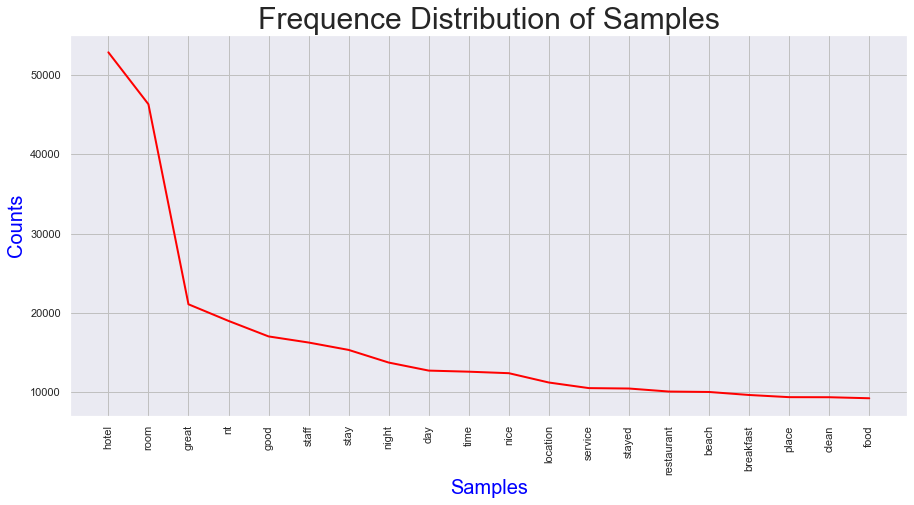

In [97]:
## Plotting a fdist plot for Frequence Distribution of above Samples
plt.figure(figsize=(15,7))  # the size you want
plt.title("Frequence Distribution of Samples",size=30, y=1)

plt.xlabel('Samples', size=20, color='blue')  # X  axis  name
plt.ylabel('Count', size=20, color='blue')      # Y  axis  name

fdist.plot(20,cumulative=False, color='red')

plt.show()

## B] WORDCLOUD (Generating from "complete_review_string")

## a) Positive-Word corpus with WordCloud analysis
#### "review_pos"

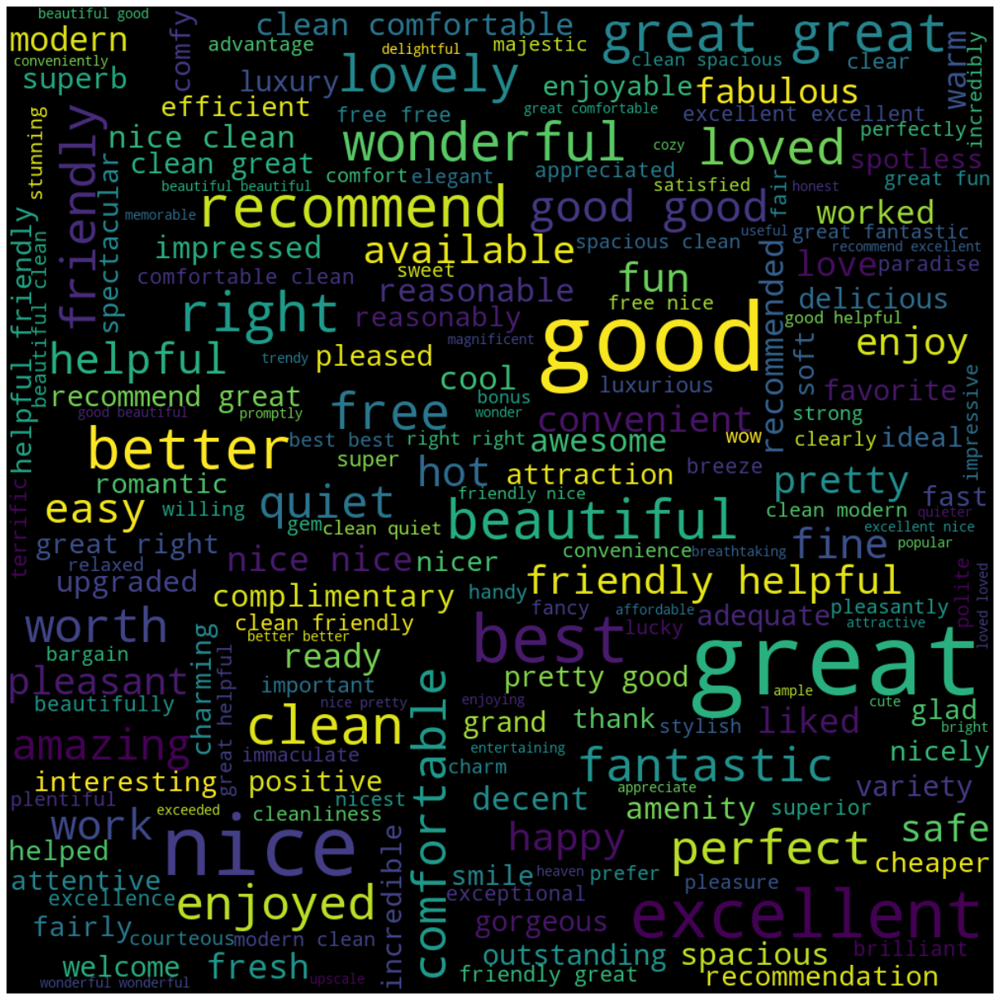

In [27]:
from wordcloud import WordCloud

with open("positive-words.txt","r", encoding="utf-8") as pos:
    poswords = pos.read().split("\n")  

review_pos = " ".join ([w for w in words if w in poswords])

wordCloudPos = WordCloud(width = 1000, height = 1000, random_state = 21, max_font_size = 100).generate(review_pos)
plt.figure(figsize=(20, 20), dpi=80)
plt.imshow(wordCloudPos, interpolation = "bilinear")
plt.axis("off")
plt.show()

# Note: Need to use encoding="utf-8" for any error (UnicodeDecodeError: 'charmap' codec can't decode byte)

In [ ]:
Most of the words are indeed related to the customer experience with the hotel stay: great, good, nice, perfect, loved, enjoyed, friendly, comfortable etc.
Some words are more related to hotels: room, amenity, clean, staff, etc

In [28]:
## Tokenizing the most common Positive-words('review_pos') using NLTK.word_tokenize library function
### word_tokenize is a function in Python that splits a given sentence into words using the NLTK library.

pos_words = nltk.word_tokenize(review_pos)
fdistPos = FreqDist(pos_words)
fdistPos.most_common(15)

[('great', 21088),
 ('good', 17036),
 ('nice', 12399),
 ('clean', 9368),
 ('like', 8181),
 ('friendly', 6671),
 ('excellent', 6008),
 ('best', 5678),
 ('helpful', 5454),
 ('recommend', 4848),
 ('beautiful', 4657),
 ('comfortable', 4407),
 ('right', 4255),
 ('better', 4057),
 ('wonderful', 4042)]

## b) Negative-Word corpus with WordCloud analysis 
#### "review_neg"

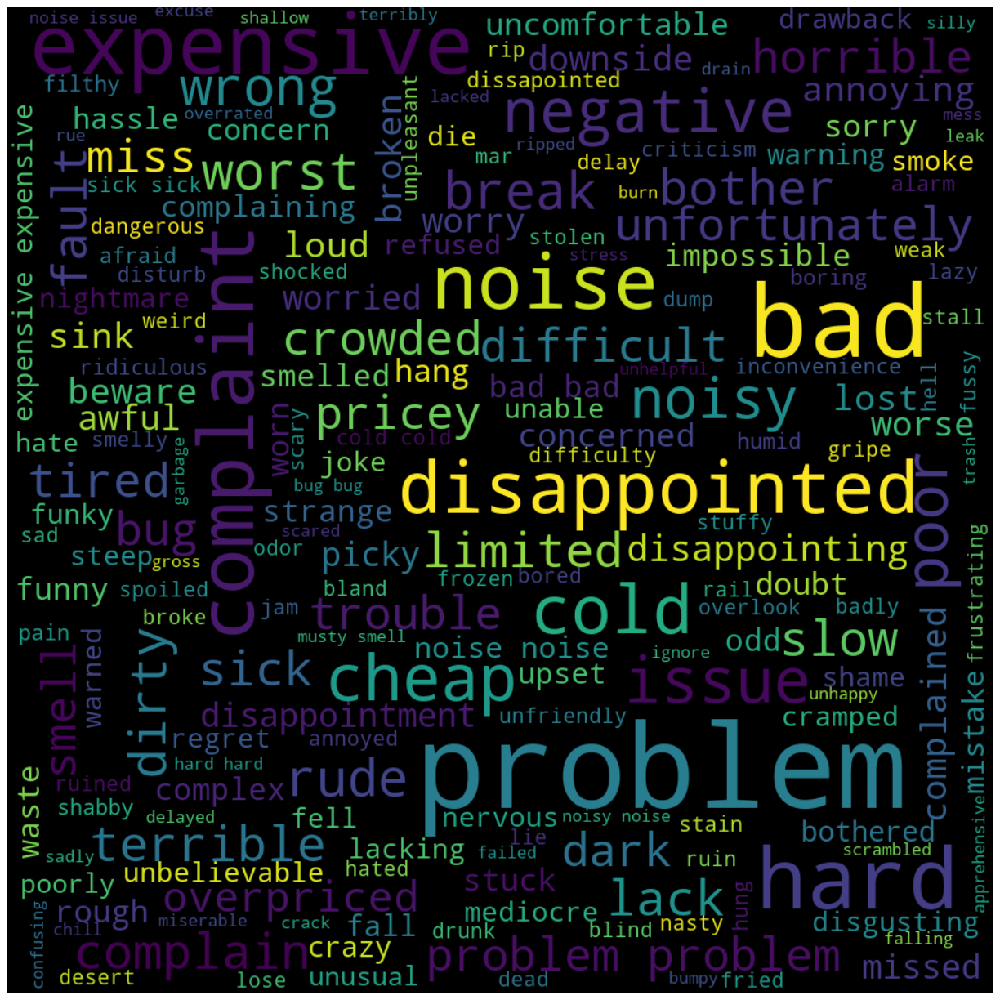

In [29]:

with open("negative-words.txt","r", encoding='utf-8') as pos:
    negwords = pos.read().split("\n")  

review_neg = " ".join ([w for w in words if w in negwords])

wordCloudNeg = WordCloud(width = 1000, height = 1000, random_state = 21, max_font_size = 119).generate(review_neg)
plt.figure(figsize=(20, 20), dpi=80)
plt.imshow(wordCloudNeg, interpolation = "bilinear")
plt.axis("off")
plt.show()

In [ ]:
Words are related to the customer experience with the hotel stay: Problem, bad, noise, disappointed, worst etc.
Some words are more related to hotels: expensive, smell, cold, dirty, noisy, rude

In [58]:
## Tokenizing the above Negative-words('review_neg') using NLTK.word_tokenize library function

neg_words = nltk.word_tokenize(review_neg)  # Review_neg is our object 
fdistNeg = FreqDist(neg_words)
fdistNeg.most_common(20)

[('problem', 4374),
 ('bad', 2838),
 ('noise', 2242),
 ('expensive', 1921),
 ('hard', 1788),
 ('complaint', 1370),
 ('cold', 1296),
 ('disappointed', 1204),
 ('issue', 1115),
 ('cheap', 1091),
 ('noisy', 995),
 ('negative', 939),
 ('poor', 909),
 ('smell', 811),
 ('sick', 777),
 ('worst', 735),
 ('dirty', 730),
 ('rude', 728),
 ('wrong', 713),
 ('break', 696)]

In [31]:
data.head()

,Review,Rating,clean_reviews
0,nice hotel expensive parking got good deal sta...,4,nice hotel expensive parking got good deal sta...
1,ok nothing special charge diamond member hilto...,2,ok nothing special charge diamond member hilto...
2,nice rooms not 4* experience hotel monaco seat...,3,nice room experience hotel monaco seattle goo...
3,"unique, great stay, wonderful time hotel monac...",5,unique great stay wonderful time hotel monaco ...
4,"great stay great stay, went seahawk game aweso...",5,great stay great stay went seahawk game awesom...


# FEATURE ENGINEERING:

## Sentiment Analysis Using TextBLOB

In [17]:
# Importng the dataset and assigning Review_length
data = pd.read_excel(r'C:\Users\SOUMYA\Downloads\Project 139\hotel_reviews.xlsx')
data['Review_length'] = data['Review'].apply(len)
data

,Review,Rating,Review_length
0,nice hotel expensive parking got good deal sta...,4.0,593
1,ok nothing special charge diamond member hilto...,2.0,1689
2,nice rooms not 4* experience hotel monaco seat...,3.0,1427
3,"unique, great stay, wonderful time hotel monac...",5.0,600
4,"great stay great stay, went seahawk game aweso...",5.0,1281
...,...,...,...
20486,"best kept secret 3rd time staying charm, not 5...",5.0,733
20487,great location price view hotel great quick pl...,4.0,306
20488,"ok just looks nice modern outside, desk staff ...",2.0,443
20489,hotel theft ruined vacation hotel opened sept ...,1.0,5557


### Creating 'Analysis(Rating)' 
rating less than 3 is Negative
equal to 3 is Neutral
Greater than 3 is Positive

In [18]:
# Creating a function to divide the reviews into three categories - Positive, Neutral & Negative, based on Ratings.

def rating_analysis(rating):
  if rating < 3:
    return 'Negative'
  elif rating == 3:
    return 'Neutral'
  else:
    return 'Positive'

# Applying the funtion to the rating column.

data['Analysis(Rating)'] = data['Rating'].apply(rating_analysis)
data

,Review,Rating,Review_length,Analysis(Rating)
0,nice hotel expensive parking got good deal sta...,4.0,593,Positive
1,ok nothing special charge diamond member hilto...,2.0,1689,Negative
2,nice rooms not 4* experience hotel monaco seat...,3.0,1427,Neutral
3,"unique, great stay, wonderful time hotel monac...",5.0,600,Positive
4,"great stay great stay, went seahawk game aweso...",5.0,1281,Positive
...,...,...,...,...
20486,"best kept secret 3rd time staying charm, not 5...",5.0,733,Positive
20487,great location price view hotel great quick pl...,4.0,306,Positive
20488,"ok just looks nice modern outside, desk staff ...",2.0,443,Negative
20489,hotel theft ruined vacation hotel opened sept ...,1.0,5557,Negative


### Subjectivity and Polarity

In [72]:
# Importing text blob for sentiment analysis.
from textblob import TextBlob

# Creating a function to get the Subjectivity.
def get_subjectivity(text):
  return TextBlob(text).sentiment.subjectivity


# Creating a function to get the Polarity.
def get_polarity(text):
  return TextBlob(text).sentiment.polarity


# Creating two columns for Subjectivity and Polarity, And applying the functions.
data['Subjectivity'] = data['Review'].apply(get_subjectivity)
data['Polarity'] = data['Review'].apply(get_polarity)
data.tail()

,Review,Rating,Review_length,Analysis(Rating),Subjectivity,Polarity
20486,"best kept secret 3rd time staying charm, not 5...",5,733,Positive,0.508586,0.221729
20487,great location price view hotel great quick pl...,4,306,Positive,0.622222,0.503704
20488,"ok just looks nice modern outside, desk staff ...",2,443,Negative,0.524304,0.171220
20489,hotel theft ruined vacation hotel opened sept ...,1,5557,Negative,0.533441,0.122573
20490,"people talking, ca n't believe excellent ratin...",2,620,Negative,0.626190,0.110615


### Creating 'Analysis(Polarity)' score based on Polarity Score
if less than 0 : Negative
    equal to 0: neutral
    Greater than 0: Positive

In [73]:
# Creating a function to do the analysis and divide the reviews into three categories - Positive, Neutral & Negative, based on the Polarity.
## 5,4: Positive; 3:Neutral;  2,1: Negative

def get_analysis(score):
  if score < 0:
    return 'Negative'
  elif score == 0:
    return 'Neutral'
  else:
    return 'Positive'

# Applying the analysis function to the reviews.


data['Analysis(Polarity)'] = data['Polarity'].apply(get_analysis)
data

,Review,Rating,Review_length,Analysis(Rating),Subjectivity,Polarity,Analysis(Polarity)
0,nice hotel expensive parking got good deal sta...,4,593,Positive,0.687000,0.208744,Positive
1,ok nothing special charge diamond member hilto...,2,1689,Negative,0.495009,0.214923,Positive
2,nice rooms not 4* experience hotel monaco seat...,3,1427,Neutral,0.605208,0.294420,Positive
3,"unique, great stay, wonderful time hotel monac...",5,600,Positive,0.691228,0.504825,Positive
4,"great stay great stay, went seahawk game aweso...",5,1281,Positive,0.629396,0.384615,Positive
...,...,...,...,...,...,...,...
20486,"best kept secret 3rd time staying charm, not 5...",5,733,Positive,0.508586,0.221729,Positive
20487,great location price view hotel great quick pl...,4,306,Positive,0.622222,0.503704,Positive
20488,"ok just looks nice modern outside, desk staff ...",2,443,Negative,0.524304,0.171220,Positive
20489,hotel theft ruined vacation hotel opened sept ...,1,5557,Negative,0.533441,0.122573,Positive


<AxesSubplot:xlabel='Analysis(Rating)', ylabel='count'>

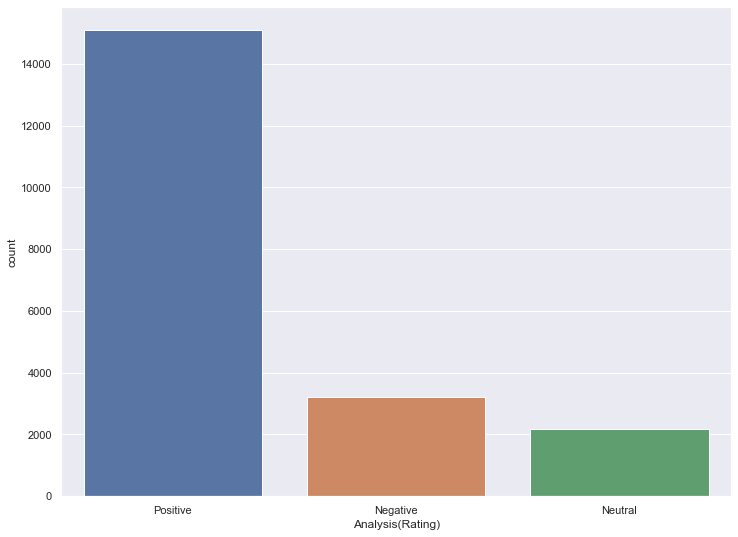

In [106]:
# Plotting Analysis based on "Analysis(Rating)""

sns.countplot(data['Analysis(Rating)'])

In [107]:
data['Analysis(Rating)'].value_counts()

Positive    15093
Negative     3214
Neutral      2184
Name: Analysis(Rating), dtype: int64

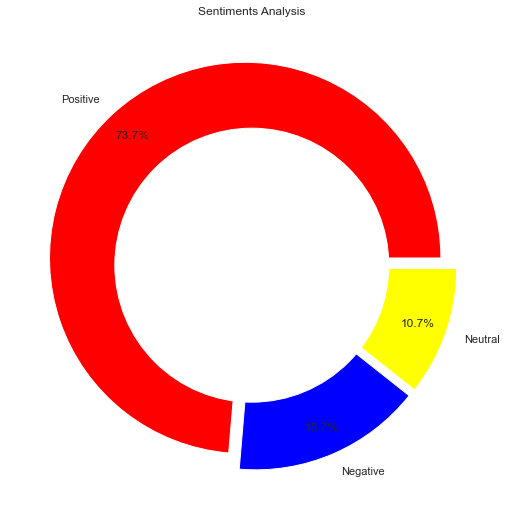

In [76]:
# Setting labels for items in Chart
sentiment_value = ['Positive','Negative','Neutral']  

# Setting size in Chart based on given values
sentiment_counts = [15093, 3214, 2184]

# colors
colors = ['#FF0000', '#0000FF', '#FFFF00']

# explosion
explode = (0.05, 0.05, 0.05)

# Pie Chart
plt.pie(sentiment_counts, colors=colors, labels=sentiment_value,
        autopct='%1.1f%%', pctdistance=0.85,
        explode=explode)
  
# draw circle
centre_circle = plt.Circle((0, 0), 0.70, fc='white')
fig = plt.gcf()
  
# Adding Circle in Pie chart
fig.gca().add_artist(centre_circle)
  
# Adding Title of chart
plt.title('Sentiments Analysis')
  
# Displaying Chart
plt.show()

<AxesSubplot:xlabel='Analysis(Polarity)', ylabel='count'>

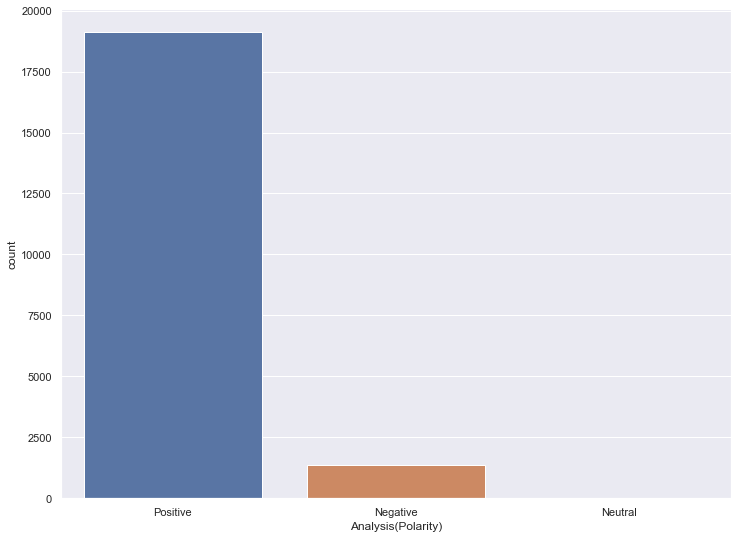

In [108]:
# Plotting Analysis based on 'Analysis(Polarity)' of reviews.

sns.countplot(data['Analysis(Polarity)'])

In [78]:
data['Analysis(Polarity)'].value_counts()

Positive    19112
Negative     1356
Neutral        23
Name: Analysis(Polarity), dtype: int64

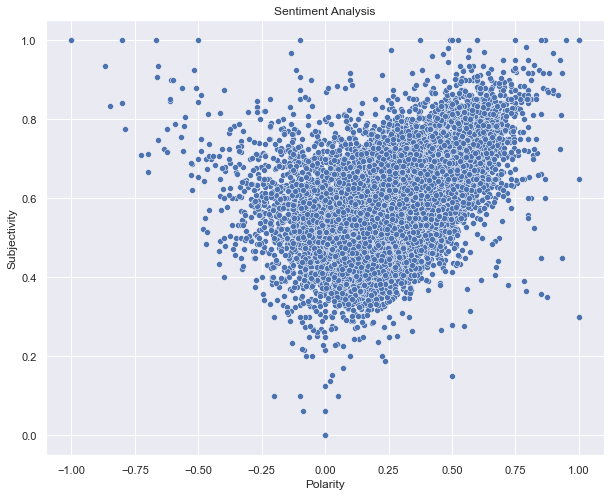

In [79]:
# # Plotting the Polarity vs Subjectivity plot.

plt.figure(figsize=(10,8))
sns.scatterplot(data['Polarity'], data['Subjectivity'])
plt.title('Sentiment Analysis')
plt.xlabel('Polarity')
plt.ylabel('Subjectivity')
plt.show()

In [80]:
data

,Review,Rating,Review_length,Analysis(Rating),Subjectivity,Polarity,Analysis(Polarity)
0,nice hotel expensive parking got good deal sta...,4,593,Positive,0.687000,0.208744,Positive
1,ok nothing special charge diamond member hilto...,2,1689,Negative,0.495009,0.214923,Positive
2,nice rooms not 4* experience hotel monaco seat...,3,1427,Neutral,0.605208,0.294420,Positive
3,"unique, great stay, wonderful time hotel monac...",5,600,Positive,0.691228,0.504825,Positive
4,"great stay great stay, went seahawk game aweso...",5,1281,Positive,0.629396,0.384615,Positive
...,...,...,...,...,...,...,...
20486,"best kept secret 3rd time staying charm, not 5...",5,733,Positive,0.508586,0.221729,Positive
20487,great location price view hotel great quick pl...,4,306,Positive,0.622222,0.503704,Positive
20488,"ok just looks nice modern outside, desk staff ...",2,443,Negative,0.524304,0.171220,Positive
20489,hotel theft ruined vacation hotel opened sept ...,1,5557,Negative,0.533441,0.122573,Positive


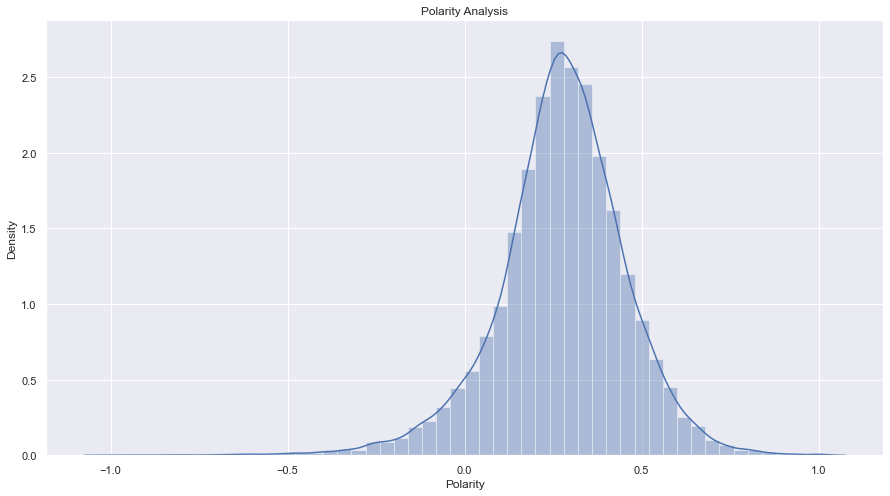

In [98]:
# plotting a density plot for polarity.

plt.figure(figsize=(15,8))
sns.distplot(data['Polarity'])
plt.title('Polarity Analysis')
plt.xlabel('Polarity')
plt.show()

In [99]:
data.head()

,Review,Rating,Review_length,Analysis(Rating),Subjectivity,Polarity,Analysis(Polarity)
0,nice hotel expensive parking got good deal sta...,4,593,Positive,0.687000,0.208744,Positive
1,ok nothing special charge diamond member hilto...,2,1689,Negative,0.495009,0.214923,Positive
2,nice rooms not 4* experience hotel monaco seat...,3,1427,Neutral,0.605208,0.294420,Positive
3,"unique, great stay, wonderful time hotel monac...",5,600,Positive,0.691228,0.504825,Positive
4,"great stay great stay, went seahawk game aweso...",5,1281,Positive,0.629396,0.384615,Positive


In [100]:
# Defining Score based on Polarity: If for Greater than 1 polarity will be "1", 
## and less than 1 polarity will be "0" and Neutral(equal to 0) will be "0"
def analysis(score):
    if score < 0:
        return "0"
    elif score == 0:
        return "-1"
    else:
        return "1"

In [102]:
data["analysis"] = data["Polarity"].apply(analysis)
data

,Review,Rating,Review_length,Analysis(Rating),Subjectivity,Polarity,Analysis(Polarity),analysis
0,nice hotel expensive parking got good deal sta...,4,593,Positive,0.687000,0.208744,Positive,1
1,ok nothing special charge diamond member hilto...,2,1689,Negative,0.495009,0.214923,Positive,1
2,nice rooms not 4* experience hotel monaco seat...,3,1427,Neutral,0.605208,0.294420,Positive,1
3,"unique, great stay, wonderful time hotel monac...",5,600,Positive,0.691228,0.504825,Positive,1
4,"great stay great stay, went seahawk game aweso...",5,1281,Positive,0.629396,0.384615,Positive,1
...,...,...,...,...,...,...,...,...
20486,"best kept secret 3rd time staying charm, not 5...",5,733,Positive,0.508586,0.221729,Positive,1
20487,great location price view hotel great quick pl...,4,306,Positive,0.622222,0.503704,Positive,1
20488,"ok just looks nice modern outside, desk staff ...",2,443,Negative,0.524304,0.171220,Positive,1
20489,hotel theft ruined vacation hotel opened sept ...,1,5557,Negative,0.533441,0.122573,Positive,1


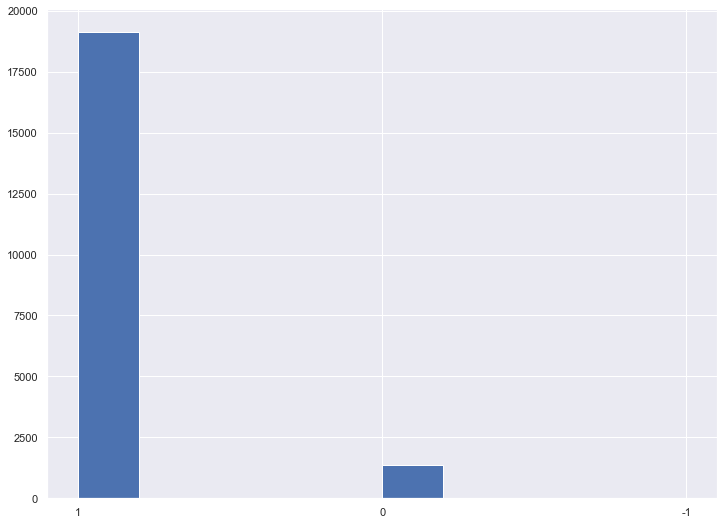

In [104]:
plt.hist(data['analysis'])
plt.show()

In [105]:
data.analysis.value_counts()

1     19112
0      1356
-1       23
Name: analysis, dtype: int64

# Model Building

In [23]:
from sklearn.preprocessing import LabelEncoder

encoder = LabelEncoder()
data['Senti_encoding'] = encoder.fit_transform(data['Analysis(Rating)'])
data

,Review,Rating,Review_length,Analysis(Rating),Senti_encoding
0,nice hotel expensive parking got good deal sta...,4.0,593,Positive,2
1,ok nothing special charge diamond member hilto...,2.0,1689,Negative,0
2,nice rooms not 4* experience hotel monaco seat...,3.0,1427,Neutral,1
3,"unique, great stay, wonderful time hotel monac...",5.0,600,Positive,2
4,"great stay great stay, went seahawk game aweso...",5.0,1281,Positive,2
...,...,...,...,...,...
20486,"best kept secret 3rd time staying charm, not 5...",5.0,733,Positive,2
20487,great location price view hotel great quick pl...,4.0,306,Positive,2
20488,"ok just looks nice modern outside, desk staff ...",2.0,443,Negative,0
20489,hotel theft ruined vacation hotel opened sept ...,1.0,5557,Negative,0


In [24]:
x = data['Review']
y = data[['Senti_encoding']]

In [22]:
x.shape

(20491,)

In [23]:
y.shape

(20491, 1)

In [25]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(data['Review'], data['Senti_encoding'], 
                                                    stratify= data['Senti_encoding'], test_size=0.20, random_state = 24)

# Decision Tree

In [123]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.pipeline import Pipeline
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
  

In [124]:
classifier = Pipeline([('tfidf', TfidfVectorizer()),
                     ('clf', DecisionTreeClassifier(criterion = "gini",
            random_state = 100,max_depth=3, min_samples_leaf=5))])


In [125]:
classifier.fit(x_train, y_train)

Pipeline(steps=[('tfidf', TfidfVectorizer()),
                ('clf',
                 DecisionTreeClassifier(max_depth=3, min_samples_leaf=5,
                                        random_state=100))])

In [126]:
classifier.score(x_train, y_train)

0.7616520253782333

In [127]:
y_pred = classifier.predict(x_test)

In [128]:
from sklearn.metrics import accuracy_score, recall_score, f1_score, precision_score

In [129]:
acc_dst=print('acc_dst :{:.2f}'.format(accuracy_score(y_test, y_pred)))
F1_dst=print('F1_dst:{:.2f}'.format(f1_score(y_test, y_pred, average='weighted')))
Precision_dst=print('Precision_dst:{:.2f}'.format(precision_score(y_test, y_pred, average='weighted')))
Recall_dst=print('Recall_dst:{:.2f}'.format(recall_score(y_test, y_pred, average='weighted')))

acc_dst :0.75
F1_dst:0.70
Precision_dst:0.67
Recall_dst:0.75


In [130]:
Text = [('The hotel was good.'),
        ('Beach near the hotel was a plus.'),
        ('Hotel service was awful')]

In [131]:
classifier.predict(Text)

array([2, 2, 2])

# Random Forest

In [132]:
from sklearn.ensemble import RandomForestClassifier

In [133]:
classifier = Pipeline([('tfidf', TfidfVectorizer()),
                     ('clf', RandomForestClassifier(n_estimators = 100))])

In [134]:
classifier.fit(x_train, y_train)

Pipeline(steps=[('tfidf', TfidfVectorizer()),
                ('clf', RandomForestClassifier())])

In [135]:
classifier.score(x_train, y_train)

1.0

In [136]:
y_pred = classifier.predict(x_test)

In [137]:
acc_rf=print('acc_rf :{:.2f}'.format(accuracy_score(y_test, y_pred)))
F1_rf=print('F1_rf:{:.2f}'.format(f1_score(y_test, y_pred, average='weighted')))
Precision_rf=print('Precision_rf:{:.2f}'.format(precision_score(y_test, y_pred, average='weighted')))
Recall_rf=print('Recall_rf:{:.2f}'.format(recall_score(y_test, y_pred, average='weighted')))

acc_rf :0.79
F1_rf:0.73
Precision_rf:0.72
Recall_rf:0.79


In [138]:
Text = [('The hotel was good.'),
        ('Beach near the hotel was a plus.'),
        ('Hotel service was awful')]

In [139]:
classifier.predict(Text)

array([2, 2, 2])

# XGBoost

In [140]:
from xgboost import XGBClassifier


classifier = Pipeline([('tfidf', TfidfVectorizer()),
                     ('clf', XGBClassifier())])

In [141]:
classifier.fit(x_train, y_train)
classifier.score(x_train, y_train)

0.9767569546120058

In [142]:
y_pred = classifier.predict(x_test)

In [143]:
acc_xgb=print('acc_xgb :{:.2f}'.format(accuracy_score(y_test, y_pred)))
F1_xgb=print('F1_xgb:{:.2f}'.format(f1_score(y_test, y_pred, average='weighted')))
Precision_xgb=print('Precision_xgb:{:.2f}'.format(precision_score(y_test, y_pred, average='weighted')))
Recall_xgb=print('Recall_xgb:{:.2f}'.format(recall_score(y_test, y_pred, average='weighted')))

acc_xgb :0.85
F1_xgb:0.83
Precision_xgb:0.82
Recall_xgb:0.85


In [144]:
Text = [('The hotel was good.'),
        ('Beach near the hotel was a plus.'),
        ('Hotel service was awful')]

classifier.predict(Text)

array([2, 2, 0], dtype=int64)

# SVM

In [145]:
from sklearn import svm

classifier = Pipeline([('tfidf', TfidfVectorizer()),
                     ('clf', svm.LinearSVC())])

In [146]:
classifier.fit(x_train, y_train)

Pipeline(steps=[('tfidf', TfidfVectorizer()), ('clf', LinearSVC())])

In [147]:
classifier.score(x_train, y_train)

0.9871278672523182

In [148]:
y_pred = classifier.predict(x_test)

In [149]:
acc_svm=print('acc_svm :{:.2f}'.format(accuracy_score(y_test, y_pred)))
F1_svm=print('F1_svm:{:.2f}'.format(f1_score(y_test, y_pred, average='weighted')))
Precision_svm=print('Precision_svm:{:.2f}'.format(precision_score(y_test, y_pred, average='weighted')))
Recall_svm=print('Recall_svm:{:.2f}'.format(recall_score(y_test, y_pred, average='weighted')))

acc_svm :0.85
F1_svm:0.84
Precision_svm:0.83
Recall_svm:0.85


In [150]:
Text = [('The hotel was good.'),
        ('Beach near the hotel was a plus.'),
        ('Hotel service was awful')]

classifier.predict(Text)

array([2, 2, 0])

# Logistic Classifier

In [151]:
from sklearn.linear_model import LogisticRegression

In [152]:
classifier = Pipeline([('tfidf', TfidfVectorizer()),
                     ('clf', LogisticRegression(multi_class = 'ovr')),])

In [153]:
classifier.fit(x_train, y_train)

Pipeline(steps=[('tfidf', TfidfVectorizer()),
                ('clf', LogisticRegression(multi_class='ovr'))])

In [154]:
classifier.score(x_train, y_train)

0.8892752562225475

In [155]:
y_pred = classifier.predict(x_test)

In [156]:
acc_LR=print('acc_LR :{:.2f}'.format(accuracy_score(y_test, y_pred)))
F1_LR=print('F1_LR:{:.2f}'.format(f1_score(y_test, y_pred, average='weighted')))
Precision_LR=print('Precision_LR:{:.2f}'.format(precision_score(y_test, y_pred, average='weighted')))
Recall_LR=print('Recall_LR:{:.2f}'.format(recall_score(y_test, y_pred, average='weighted')))

acc_LR :0.86
F1_LR:0.83
Precision_LR:0.83
Recall_LR:0.86


In [157]:
Text = [('The hotel was good.'),
        ('Beach near the hotel was a plus.'),
        ('Hotel service was awful')]

classifier.predict(Text)

array([2, 2, 0])

# KNN

In [158]:
from sklearn.neighbors import KNeighborsClassifier

In [159]:
classifier = Pipeline([('tfidf', TfidfVectorizer()),
                     ('clf', KNeighborsClassifier(n_neighbors=5)),])

classifier.fit(x_train, y_train)

Pipeline(steps=[('tfidf', TfidfVectorizer()), ('clf', KNeighborsClassifier())])

In [160]:
KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                    weights='uniform')

KNeighborsClassifier()

In [161]:
classifier.score(x_train, y_train)

0.8385187896534895

In [162]:
y_pred = classifier.predict(x_test)

In [163]:
acc_knn=print('acc_knn :{:.2f}'.format(accuracy_score(y_test, y_pred)))
F1_knn=print('F1_knn:{:.2f}'.format(f1_score(y_test, y_pred, average='weighted')))
Precision_knn=print('Precision_knn:{:.2f}'.format(precision_score(y_test, y_pred, average='weighted')))
Recall_knn=print('Recall_knn:{:.2f}'.format(recall_score(y_test, y_pred, average='weighted')))

acc_knn :0.79
F1_knn:0.75
Precision_knn:0.74
Recall_knn:0.79


In [164]:
Text = [('The hotel was good.'),
        ('Beach near the hotel was a plus.'),
        ('Hotel service was awful')]

classifier.predict(Text)

array([2, 0, 0])

# Naive Bayes Classifier

In [165]:
from sklearn.naive_bayes import MultinomialNB
classifier = Pipeline([('tfidf', TfidfVectorizer()),
                     ('clf', MultinomialNB())])

In [166]:
classifier.fit(x_train, y_train)

Pipeline(steps=[('tfidf', TfidfVectorizer()), ('clf', MultinomialNB())])

In [167]:
classifier.score(x_train, y_train)

0.7410322108345534

In [168]:
y_pred = classifier.predict(x_test)

In [169]:
acc_mulnb=print('acc_mulnb :{:.2f}'.format(accuracy_score(y_test, y_pred)))
F1_mulnb=print('F1_mulnb:{:.2f}'.format(f1_score(y_test, y_pred, average='weighted')))
Precision_mulnb=print('Precision_mulnb:{:.2f}'.format(precision_score(y_test, y_pred, average='weighted')))
Recall_mulnb=print('Recall_mulnb:{:.2f}'.format(recall_score(y_test, y_pred, average='weighted')))

acc_mulnb :0.74
F1_mulnb:0.63
Precision_mulnb:0.70
Recall_mulnb:0.74


In [170]:
Text = [('The hotel was good.'),
        ('Beach near the hotel was a plus.'),
        ('Hotel service was awful')]

classifier.predict(Text)

array([2, 2, 2])

# Comparing The Models

In [177]:
Data1={'model':['Decision Tree','Random forest','SVM','XGb','NB','KNN','Logistic'],
       'Accuracy':[0.75,0.79,0.85,0.85,0.74,0.79,0.86],
      'F1 Score':[0.70,0.73,0.84,0.83,0.63,0.75,0.83],
      'Precision':[0.67,0.72,0.83,0.82,0.70,0.74,0.83],
      'Recall':[0.79,0.79,0.85,0.85,0.74,0.79,0.86]}

In [178]:
Data1_df= pd.DataFrame(Data1)

In [179]:
Data1_df

,model,Accuracy,F1 Score,Precision,Recall
0,Decision Tree,0.75,0.70,0.67,0.79
1,Random forest,0.79,0.73,0.72,0.79
2,SVM,0.85,0.84,0.83,0.85
3,XGb,0.85,0.83,0.82,0.85
4,NB,0.74,0.63,0.70,0.74
5,KNN,0.79,0.75,0.74,0.79
6,Logistic,0.86,0.83,0.83,0.86
